<a href="https://colab.research.google.com/github/EfeSenerr/Thesis/blob/main/Thesis_BERTopic_Big_Data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **BERTopic on Large Datasets**

Due to the modularity of BERTopic, it can also be used on large datasets (> 1_000_000) if we change some of the internal algorithms such that they can scale a bit better.

To do so, this example uses Google Colab Pro (T4 with 25GB of VRAM and 26GB of System RAM) and cuML to enable GPU-accelerated machine learning.

First, we will need to install some packages:

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install git+https://github.com/MaartenGr/BERTopic.git@master

!pip install cudf-cu11 dask-cudf-cu11 --extra-index-url=https://pypi.nvidia.com
!pip install cuml-cu11 --extra-index-url=https://pypi.nvidia.com
!pip install cugraph-cu11 --extra-index-url=https://pypi.nvidia.com
!pip install cupy-cuda11x -f https://pip.cupy.dev/aarch64

!pip install safetensors
!pip install datasets
!pip install datashader
!pip install adjustText

  Cloning https://github.com/MaartenGr/BERTopic.git (to revision master) to /tmp/pip-req-build-52sh1u28
  Running command git clone --filter=blob:none --quiet https://github.com/MaartenGr/BERTopic.git /tmp/pip-req-build-52sh1u28
  Resolved https://github.com/MaartenGr/BERTopic.git to commit fc9a51aee18011afbbf4045f30460c2970527c49
  Preparing metadata (setup.py) ... done
Looking in indexes: https://pypi.org/simple, https://pypi.nvidia.com
Looking in indexes: https://pypi.org/simple, https://pypi.nvidia.com
Looking in indexes: https://pypi.org/simple, https://pypi.nvidia.com
Looking in links: https://pip.cupy.dev/aarch64


In [ ]:
!git clone https://github.com/jparksecurity/rapidsai-csp-utils.git
!python rapidsai-csp-utils/colab/pip-install.py

In [ ]:
# !pip install --upgrade setuptools wheel

In [ ]:
import cuml
cuml.__version__

'23.10.00'

Sometimes, it might happen that you get the `NotImplementedError: A UTF-8 locale is required. Got ANSI_X3.4-1968` error, if so make sure to run the following code:

```python
import locale
locale.getpreferredencoding = lambda: "UTF-8"
```

**(Optional)** We can mount a personal Google Drive such that we can save the resulting embeddings and models that you create. Although it is not necessary, if you created embeddings and then run into memory errors, it is generally nice to have the embeddings saved somewhere without needing to recalculate them.

My data is at: './content/drive/MyDrive/data_tr'

# **Data**

To show how BERTopic can be used with large data, we are going to load in some Wikipedia texts. Cohere has fortunately created a dataset split by paragraphs, which allows us to stay within token limit sizes.

For this example, we load in 1 million texts from Wikipedia and see if we can extract topics from them.

In [ ]:
# from datasets import load_dataset

# # Extract 1 millions records
# lang = 'en'
# data = load_dataset(f"Cohere/wikipedia-22-12", lang, split='train', streaming=True)
# docs = [doc["text"] for doc in data if doc["id"] != "1_000_000"]; len(docs)

In [ ]:
import os
import re
import warnings
import pandas as pd
import json
import logging
import numpy as np
from concurrent.futures import ThreadPoolExecutor
import dask.dataframe as dd

In [ ]:
import torch
print(torch.cuda.is_available())

True


In [ ]:
# Loggings
warnings.filterwarnings(action='ignore', category=FutureWarning)

# Configure logging to write to a file and the console
logging.basicConfig(
    level=logging.INFO,
    format='%(asctime)s - %(name)s - %(levelname)s - %(message)s',
    handlers=[
        logging.FileHandler(filename='analysis.log'),
        logging.StreamHandler()
    ]
)

In [ ]:
# Predifined functions
def extract_number(filename):
    # Regular expression to match a sequence of digits
    match = re.search(r'_(\d+)\.csv$', filename)
    return int(match.group(1)) if match else 0

def process_file(file_name):
    try:
        file_path = os.path.join(input_folder_path, file_name)
        logging.info(f'Reading file: {file_name}')
        df = pd.read_csv(file_path)
        df = df.dropna(subset=['text'])
        return df["text"].tolist()
    except Exception as e:
        logging.error(f"Error processing file {file_name}: {e}")
        return []

# Function to clean or convert 'tweet_id'
def clean_tweet_id(val):
    try:
        return int(val)  # Convert to integer if possible
    except ValueError:
        return pd.NA  # Use Pandas NA for missing values

In [ ]:
!pwd

/content


In [ ]:
input_folder_path = '/content/drive/MyDrive/data_tr/tweetnet/'
# files = [f for f in os.listdir(input_folder_path) if f.endswith('.csv')]
# sorted_files = sorted(files, key=extract_number)

Data read

In [ ]:
import glob

all_files = glob.glob(os.path.join(input_folder_path, '**/*.csv'), recursive=True)

# Create a list to hold DataFrames
dfs = []

In [ ]:

# # Iterate over the list of file paths & read each file
# for file in all_files:
#     df = pd.read_csv(file, warn_bad_lines=True, error_bad_lines=False)
#     dfs.append(df)

# # Concatenate all DataFrames into a single DataFrame
# combined_df = pd.concat(dfs, ignore_index=True)

In [ ]:
# # investigate
# def read_csv_file(file_path):
#     try:
#         return pd.read_csv(file_path, error_bad_lines=False, warn_bad_lines=True)
#     except pd.errors.ParserError as e:
#         print(f"Error in file: {file_path}")
#         print(e)
#         return pd.DataFrame()  # Return an empty DataFrame in case of error

# combined_df = pd.concat([read_csv_file(file) for file in all_files], ignore_index=True)

In [ ]:
# works but taking ages
def read_csv_in_chunks(file_path, chunk_size=10000):
    try:
        chunks = pd.read_csv(file_path, chunksize=chunk_size)
        df_list = [chunk for chunk in chunks]  # List comprehension to gather chunks
        return pd.concat(df_list, ignore_index=True)
    except pd.errors.ParserError as e:
        print(f"Error in file: {file_path}")
        print(e)
        return pd.DataFrame()  # Return an empty DataFrame in case of error

combined_df = pd.concat([read_csv_in_chunks(file) for file in all_files], ignore_index=True)

In [ ]:
# Define the data types for the columns, setting 'tweet_id' as object
dtypes = {'tweet_id': 'object', 'text': 'object', 'created_at': 'object', 'hashtags': 'object', 'lang': 'object'}  # Adjust for other columns as necessary

# Read csv files into a Dask DataFrame with specified dtypes
# df = dd.read_csv(os.path.join(input_folder_path, '**/*.csv'))


In [ ]:
df = combined_df.copy()

In [ ]:
# df = pd.loc[:, ['tweet_id', 'text']]
df = df[['tweet_id', 'text']]

In [ ]:
# Apply the cleaning function to 'tweet_id'
# df['tweet_id'] = df['tweet_id'].map(clean_tweet_id, meta=('tweet_id', 'object'))
df['tweet_id'] = df['tweet_id'].map(clean_tweet_id)

In [ ]:
# Drop NaN values from 'text' column and persist
# df = df.dropna(subset=['text']).persist()
df = df.dropna(subset=['text'])
# Convert to Pandas DataFrame for analysis (if manageable size after dropping NaN)
# df = df.compute()

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7829019 entries, 2 to 25615825
Data columns (total 2 columns):
 #   Column    Dtype 
---  ------    ----- 
 0   tweet_id  object
 1   text      object
dtypes: object(2)
memory usage: 179.2+ MB


In [ ]:
# df = pd.read_csv("../../data/output/test_Folder/output_text1.csv")
# df = df.dropna(subset=['text'])
docs = df["text"].tolist()
docs = [doc for doc in docs if pd.notnull(doc) and doc != '']

In [ ]:
# import pickle
# # Save the list to a file
# with open('/content/drive/MyDrive/data_tr/docs.pkl', 'wb') as file:
#     pickle.dump(docs, file)

In [ ]:
# Load the list from the file
# import pickle
# with open('/content/drive/MyDrive/data_tr/docs_05_06.pkl', 'rb') as file:
#     loaded_list = pickle.load(file)

In [ ]:
docs = loaded_list

In [ ]:
# # Assuming 'docs' is your original list of documents
# half_length = len(docs) // 2  # Integer division to get half the length of the list
# first_half_docs = docs[:half_length]  # Slice the first half

read sample csv

In [ ]:
# Load from CSV
sampled_tweets_df = pd.read_csv('/content/drive/MyDrive/data_tr/tweet_sample.csv')

In [ ]:
docs = sampled_tweets_df['text'].tolist()

# **Basic Example**

Now that we have our data, we can start with a basic example. This example shows the minimum steps necessary for training a BERTopic model on large datasets. Do note though that memory errors are still possible when tweaking parameters. After this section, some tips and tricks will be mentioned to demonstrate how we can further reduce memory or be more efficient with our training process.

## Embeddings

Next, we are going to pre-calculate the embeddings as input for our BERTopic model. The reason for doing this is that this input step can take quite some time to compute. If we pre-calculate them and save the resulting embeddings, we can skip over this step when we are iterating over our model.

In [ ]:
# !pip install -U sentence-transformers

In [ ]:
from sentence_transformers import SentenceTransformer

# Create embeddings
model = SentenceTransformer('sentence-transformers/paraphrase-multilingual-MiniLM-L12-v2')

2023-12-10 11:21:47,744 - sentence_transformers.SentenceTransformer - INFO - Load pretrained SentenceTransformer: sentence-transformers/paraphrase-multilingual-MiniLM-L12-v2
2023-12-10 11:21:52,526 - sentence_transformers.SentenceTransformer - INFO - Use pytorch device: cuda


In [ ]:
# embeddings = model.encode(docs, show_progress_bar=True)

Batches:   0%|          | 0/20884 [00:00<?, ?it/s]

Another approach would be to embed the csv files one by one. IDK if it will be last long

In [ ]:
# import numpy as np
# import glob

# # Assuming you have a directory for each month
# for month in months:  # Replace 'months' with your list or range of months
#     # Dynamically get the list of embedding files for the month
#     embedding_files = glob.glob(f'path/to/{month}/embeddings_chunk_*.npy')

#     # Load and combine embeddings for the month
#     month_embeddings = [np.load(file) for file in embedding_files]
#     combined_embeddings = np.concatenate(month_embeddings, axis=0)

#     # Now 'combined_embeddings' is ready for further analysis for this month
#     # You can process it or save it for combined analysis later


We can save the resulting embeddings as follows:

In [ ]:
import numpy as np
import datetime

# Get the current date and time
current_time = datetime.datetime.now()

# Format the date and time in the desired format (e.g., 'YYYYMMDD_HHMMSS')
timestamp = current_time.strftime('%Y%m%d_%H%M%S')

file_name = f'/content/drive/MyDrive/data_tr/embeddings/embeddings_sample_tweets_{timestamp}.npy'

with open(file_name, 'wb') as f:
    np.save(f, embeddings)

and then load the embeddings as follows:

In [ ]:
embeddings = np.load('/content/drive/MyDrive/data_tr/embeddings/embeddings_sample_tweets_20231210_105957.npy')

## Prepare Vocab

Before we can start with training our model, there is still something that we can do to reduce the necessary memory. We can prepare our vocabulary beforehand such that the tokenizer does not need to do the calculations itself.

Below, we are essentially creating a vocabulary of words in our dataset and parsing them such that they need to appear at least 15 times in our data.

With sufficient RAM, we could skip over this step but I have found this often helps in reducing the necessary RAM.

**Note**: If you are using a custom CountVectorizer, then it is advised to use that instead of the default CountVectorizer to build the tokenizer.

In [ ]:
import collections
from tqdm import tqdm
from sklearn.feature_extraction.text import CountVectorizer

# Extract vocab to be used in BERTopic
vocab = collections.Counter()
tokenizer = CountVectorizer().build_tokenizer()
for doc in tqdm(docs):
  vocab.update(tokenizer(doc))
vocab = [word for word, frequency in vocab.items() if frequency >= 10]; len(vocab)

100%|██████████| 668277/668277 [00:08<00:00, 75805.33it/s]


82962

## Train BERTopic

Finally, we can train our BERTopic model. We select the same sentence-transformer model as we did before. Moreover, we select cuML's HDBSCAN and UMAP models. These are GPU-accelerated versions of HDBSCAN and UMAP and allow us to speed training on such a large dataset.

In [ ]:
import nltk
from nltk.corpus import stopwords

nltk.download('stopwords')
stopwords.words('turkish')

In [ ]:
from cuml.manifold import UMAP
from cuml.cluster import HDBSCAN
# from umap import UMAP
# from hdbscan import HDBSCAN
from bertopic import BERTopic
from sentence_transformers import SentenceTransformer

# Prepare sub-models
embedding_model = SentenceTransformer('sentence-transformers/paraphrase-multilingual-MiniLM-L12-v2')
umap_model = UMAP(n_components=5, n_neighbors=15, random_state=42, metric="cosine", verbose=True)
hdbscan_model = HDBSCAN(min_samples=20, gen_min_span_tree=True, prediction_data=False, min_cluster_size=20, verbose=True)
vectorizer_model = CountVectorizer(vocabulary=vocab, stop_words=stopwords.words('turkish'))

# Fit BERTopic without actually performing any clustering
topic_model= BERTopic(
        embedding_model=embedding_model,
        umap_model=umap_model,
        hdbscan_model=hdbscan_model,
        vectorizer_model=vectorizer_model,
        verbose=True
).fit(docs, embeddings=embeddings)

.gitattributes:   0%|          | 0.00/968 [00:00<?, ?B/s]

1_Pooling/config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/4.09k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/645 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/122 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/471M [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

sentencepiece.bpe.model:   0%|          | 0.00/5.07M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/239 [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/9.08M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/480 [00:00<?, ?B/s]

unigram.json:   0%|          | 0.00/14.8M [00:00<?, ?B/s]

modules.json:   0%|          | 0.00/229 [00:00<?, ?B/s]

2023-12-10 20:27:36,299 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm


[D] [20:27:39.597769] /__w/cuml/cuml/cpp/src/umap/runner.cuh:108 n_neighbors=15
[D] [20:27:39.598673] /__w/cuml/cuml/cpp/src/umap/runner.cuh:130 Calling knn graph run
[D] [20:29:47.718013] /__w/cuml/cuml/cpp/src/umap/runner.cuh:136 Done. Calling fuzzy simplicial set
[D] [20:29:47.733314] /__w/cuml/cuml/cpp/src/umap/fuzzy_simpl_set/naive.cuh:317 Smooth kNN Distances
[D] [20:29:47.733859] /__w/cuml/cuml/cpp/src/umap/fuzzy_simpl_set/naive.cuh:319 sigmas = [ 0.0242102, 0.0399312, 0.0655601, 0.193785, 0.106875, 0.00991243, 0.037338, 0.166722, 0.110497, 0.00399226, 0.103165, 0.0461645, 0.0213803, 0.139351, 0.0260077, 0.0224398, 0.168541, 0.142054, 0.0467403, 0.0259768, 0.0361559, 0.0269096, 0.0943546, 0.129349, 0.00953388 ]

[D] [20:29:47.733913] /__w/cuml/cuml/cpp/src/umap/fuzzy_simpl_set/naive.cuh:321 rhos = [ 0.285743, 3.57628e-07, 1.19209e-07, 5.96046e-08, 4.17233e-07, 0.259002, 0.230362, 1.78814e-07, 2.98023e-07, 0.0470051, 1.19209e-07, 5.96046e-07, 0.16364, 3.57628e-07, 0.238536, 0.256

2023-12-10 20:32:13,471 - BERTopic - Dimensionality - Completed ✓
2023-12-10 20:32:13,500 - BERTopic - Cluster - Start clustering the reduced embeddings
2023-12-10 20:34:21,148 - BERTopic - Cluster - Completed ✓
2023-12-10 20:34:21,311 - BERTopic - Representation - Extracting topics from clusters using representation models.
/usr/local/lib/python3.10/dist-packages/bertopic/vectorizers/_ctfidf.py:82: RuntimeWarning: divide by zero encountered in divide
  idf = np.log((avg_nr_samples / df)+1)
2023-12-10 20:34:48,148 - BERTopic - Representation - Completed ✓


and that is it! We can inspect the topics as follows:

In [ ]:
topic_model.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,476012,-1_bir_chp_co_https,"[bir, chp, co, https, kılıçdaroğlu, seçim, kem...",[https://t.co/kMjr2YL74T\n\nUzman Çavuşlar Kad...
1,0,8405,0_allah_eylesin_versin_müslüman,"[allah, eylesin, versin, müslüman, razı, mekan...",[@suleymansoylu Allah rahmet eylesin mekanı ce...
2,1,6536,1_türk_türkiye_yüzyılı_turkey,"[türk, türkiye, yüzyılı, turkey, cumhuriyeti, ...",[Türkiye Cumhuriyeti Cumhurbaşkanı @RTErdogan ...
3,2,3804,2_kılıçdaroğlu_na_nun_nu,"[kılıçdaroğlu, na, nun, nu, kemal, aday, kılıç...","[@MertArmagan53 Kılıçdaroğlu, ŞoförünOyu Kılıç..."
4,3,3800,3_öğretmen_öğretmenler_ataması_100,"[öğretmen, öğretmenler, ataması, 100, tcmeb, ö...",[2022 KPSS puanıyla ek 55 bin öğretmen ataması...
...,...,...,...,...,...
1730,1729,20,1729_yarınlarımızın_hediyesi_aydınlık_mehmetfa...,"[yarınlarımızın, hediyesi, aydınlık, mehmetfat...",[@RTErdogan Sayın Cumhurbaşkanım;\nAydınlık ya...
1731,1730,20,1730_hz_yili_haktir_çi,"[hz, yili, haktir, çi, çavuşlara, dendi, veri,...",[Syn @turanbulent\n\n4b liye Kadro KANUNLAŞAN...
1732,1731,20,1731_konuluyor_birliğimize_ismailgunes64_ailemize,"[konuluyor, birliğimize, ismailgunes64, ailemi...",[Değerli Cumhurbaşkanım\nKadro geliyor ama ail...
1733,1732,20,1732_bra_bless_aff_emeklerinize,"[bra, bless, aff, emeklerinize, söyleyebilir, ...",[Sn. @06melihgokcek tanıtımı beğendiyseniz bir...


Lastly, it would be advised to save the model as follows:

In [ ]:
topic_model.save(
    path='/content/drive/MyDrive/data_tr/model',
    serialization="safetensors",
    save_ctfidf=True,
    save_embedding_model="sentence-transformers/paraphrase-multilingual-MiniLM-L12-v2"
)

transforming the rest of the data

In [ ]:
# For the rest of the data, process in chunks (if needed)
for chunk in data_chunks:  # 'data_chunks' should be the rest of your data divided into manageable parts
    chunk_embeddings = embedding_model.encode(chunk, show_progress_bar=True)
    topics = topic_model.transform(chunk_embeddings)
    # You can then aggregate or analyze these topics as needed

# **Advanced Tips & Tricks**

There are a number of advanced tips and tricks that you can use to make it a bit easier and more flexible to train your model at large datasets.

## UMAP

Just like we pre-computed the embeddings, we can pre-reduce the dimensionality of the embeddings with cuML's UMAP and use those.

This saves quite a bit of time since we need to reduce embeddings everytime we run BERTopic.

**NOTE**: Saving those embeddings, as we did before, is generally advised.

In [ ]:
from cuml.manifold import UMAP

# Train model and reduce dimensionality of embeddings
umap_model = UMAP(n_components=5, n_neighbors=15, random_state=42, metric="cosine", verbose=True)
reduced_embeddings = umap_model.fit_transform(embeddings)

Similarly, we can also prepare the UMAP-reduced embeddings for visualizing documents in 2D:

In [ ]:
from cuml.manifold import UMAP

# Train model and reduce dimensionality of embeddings
umap_model = UMAP(n_components=2, n_neighbors=15, random_state=42, metric="cosine", verbose=True)
reduced_embeddings_2d = umap_model.fit_transform(embeddings)

## HDBSCAN

We can even pre-compute the clusters with HDBSCAN and feed them to BERTopic to perform [manual topic modeling](https://maartengr.github.io/BERTopic/getting_started/manual/manual.html). Manual topic modeling with BERTopic means that if we already have labels of topics, we can use those to label them using a variety of [representation models](https://maartengr.github.io/BERTopic/getting_started/representation/representation.html).

BERTopic can still perform inference since inference is done on topic embeddings that are created during `fit`.

In [ ]:
from cuml.cluster import HDBSCAN

# Find clusters of semantically similar documents
hdbscan_model = HDBSCAN(min_samples=30, gen_min_span_tree=True, prediction_data=False, min_cluster_size=30, verbose=True)
clusters = hdbscan_model.fit(reduced_embeddings).labels_

## Manual BERTopic

When we have pre-computed labels, we can pass them instead of having to calculate the clusters ourselves. This allows us to skip over the embedding, dimensionality, and clustering steps!

There is one more trick though that we are going to use. We could directly give BERTopic the reduced embeddings but BERTopic will use those to create topic vectors which is not ideal. Instead, we are giving the model the full embeddings and create a custom dimensionality reduction class that will return the reduced embeddings. This gives us the best of both worlds!

In [ ]:
from cuml.cluster import HDBSCAN
from sentence_transformers import SentenceTransformer

from bertopic import BERTopic
from bertopic.cluster import BaseCluster
from bertopic.representation import KeyBERTInspired


class Dimensionality:
  """ Use this for pre-calculated reduced embeddings """
  def __init__(self, reduced_embeddings):
    self.reduced_embeddings = reduced_embeddings

  def fit(self, X):
    return self

  def transform(self, X):
    return self.reduced_embeddings


# Prepare sub-models
embedding_model = SentenceTransformer('all-MiniLM-L6-v2')
umap_model = Dimensionality(reduced_embeddings)
hdbscan_model = BaseCluster()
vectorizer_model = CountVectorizer(vocabulary=vocab, stop_words="english")
representation_model = KeyBERTInspired()

# Fit BERTopic without actually performing any clustering
topic_model= BERTopic(
        embedding_model=embedding_model,
        umap_model=umap_model,
        hdbscan_model=hdbscan_model,
        vectorizer_model=vectorizer_model,
        representation_model=representation_model,
        verbose=True
).fit(docs, embeddings=embeddings, y=clusters)

2023-05-27 13:02:56,864 - BERTopic - The dimensionality reduction algorithm did not contain the `y` parameter and therefore the `y` parameter was not used
2023-05-27 13:02:56,866 - BERTopic - Reduced dimensionality
2023-05-27 13:02:57,089 - BERTopic - Clustered reduced embeddings
/usr/local/lib/python3.10/dist-packages/bertopic/vectorizers/_ctfidf.py:69: RuntimeWarning: divide by zero encountered in true_divide
  idf = np.log((avg_nr_samples / df)+1)


In [ ]:
topic_model.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,633881,-1_cast_films_film_movie,"[cast, films, film, movie, 2020, comedy, relea...",[The developers state that the interactive sto...
1,0,18441,0_goalscorer_scored_goals_goal,"[goalscorer, scored, goals, goal, goalkeeper, ...",[Havertz continued to impress during the follo...
2,1,8518,1_khan_actor_raj_shah,"[khan, actor, raj, shah, crore, hai, actress, ...",[Padukone found further success in 2013 when a...
3,2,7521,2_married_divorced_couple_remarried,"[married, divorced, couple, remarried, engaged...","[In 1974, Getty married German Gisela Martine ..."
4,3,6765,3_cast_actress_starred_actor,"[cast, actress, starred, actor, actors, starri...",[Williams has received four Academy Award nomi...
...,...,...,...,...,...
2372,2371,30,2371_paintings_painting_paint_art,"[paintings, painting, paint, art, artist, gall...","[In 1905, O'Keeffe began art training at the S..."
2373,2372,30,2372_tulips_tulip_economists_economic,"[tulips, tulip, economists, economic, bulbs, 1...",[It is well established that prices for tulip ...
2374,2373,30,2373_squads_squad_roster_players,"[squads, squad, roster, players, teams, tourna...",[Each team must name a preliminary squad of be...
2375,2374,30,2374_entrances_subterranean_tunnel_stairs,"[entrances, subterranean, tunnel, stairs, pyra...",[Today tourists enter the Great Pyramid via th...


## Visualize Documents

In [ ]:
reduced_embeddings = UMAP(n_neighbors=10, n_components=2, min_dist=0.0, metric='cosine').fit_transform(embeddings)

In [ ]:
import itertools
import pandas as pd

# Define colors for the visualization to iterate over
colors = itertools.cycle(['#e6194b', '#3cb44b', '#ffe119', '#4363d8', '#f58231', '#911eb4', '#46f0f0', '#f032e6', '#bcf60c', '#fabebe', '#008080', '#e6beff', '#9a6324', '#fffac8', '#800000', '#aaffc3', '#808000', '#ffd8b1', '#000075', '#808080', '#ffffff', '#000000'])
color_key = {str(topic): next(colors) for topic in set(topic_model.topics_) if topic != -1}

# Prepare dataframe and ignore outliers
df = pd.DataFrame({"x": reduced_embeddings[:, 0], "y": reduced_embeddings[:, 1], "Topic": [str(t) for t in topic_model.topics_]})
df["Length"] = [len(doc) for doc in docs]
df = df.loc[df.Topic != "-1"]
df = df.loc[(df.y > -10) & (df.y < 10) & (df.x < 10) & (df.x > -10), :]
df["Topic"] = df["Topic"].astype("category")

# Get centroids of clusters
mean_df = df.groupby("Topic").mean().reset_index()
mean_df.Topic = mean_df.Topic.astype(int)
mean_df = mean_df.sort_values("Topic")

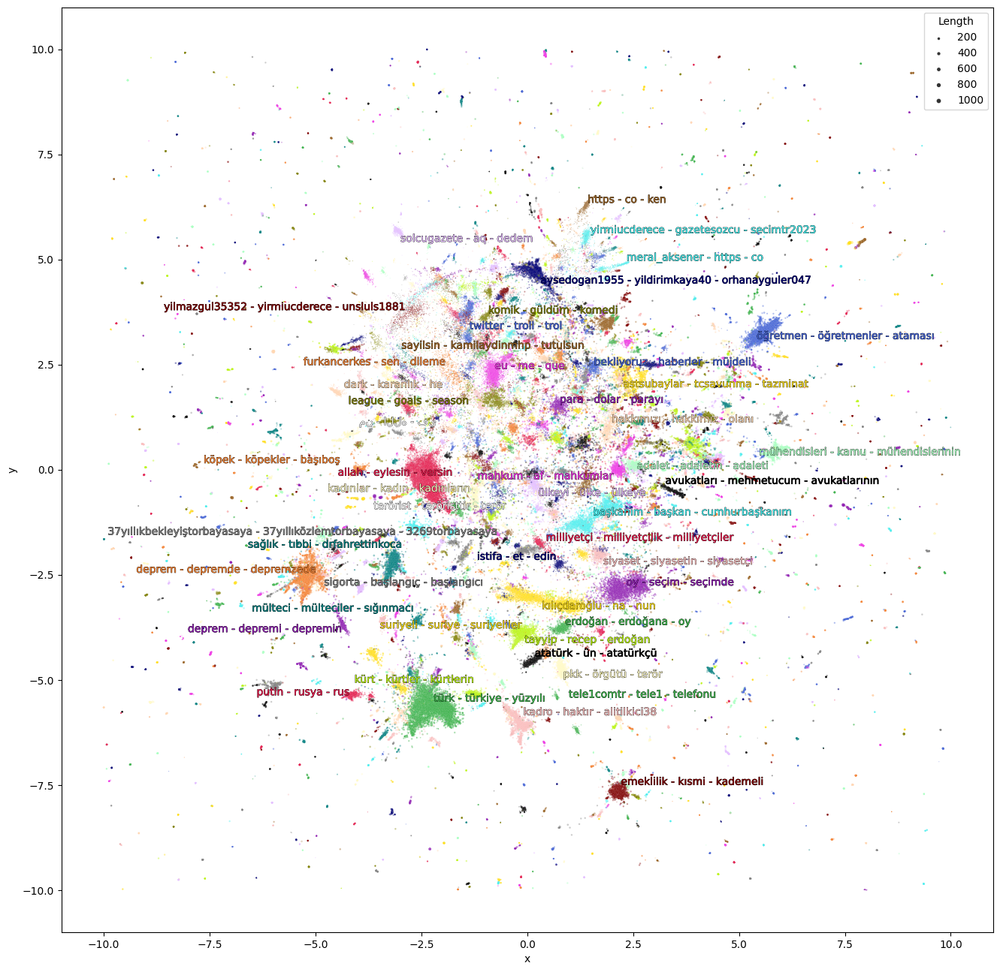

In [ ]:
import seaborn as sns
from matplotlib import pyplot as plt
from adjustText import adjust_text
import matplotlib.patheffects as pe

fig = plt.figure(figsize=(16, 16))
sns.scatterplot(data=df, x='x', y='y', c=df['Topic'].map(color_key), alpha=0.4, sizes=(0.4, 10), size="Length")

# Annotate top 50 topics
texts, xs, ys = [], [], []
for row in mean_df.iterrows():
  topic = row[1]["Topic"]
  name = " - ".join(list(zip(*topic_model.get_topic(int(topic))))[0][:3])

  if int(topic) <= 50:
    xs.append(row[1]["x"])
    ys.append(row[1]["y"])
    texts.append(plt.text(row[1]["x"], row[1]["y"], name, size=10, ha="center", color=color_key[str(int(topic))],
                          path_effects=[pe.withStroke(linewidth=0.5, foreground="black")]))

# Adjust annotations such that they do not overlap
adjust_text(texts, x=xs, y=ys, time_lim=1, force_text=(0.01, 0.02), force_static=(0.01, 0.02), force_pull=(0.5, 0.5))
plt.show()
# plt.savefig("visualization2.png", dpi=600)

In [ ]:
# topic_model.visualize_topics()

In [ ]:
# topic_model.visualize_documents(titles, reduced_embeddings=reduced_embeddings, custom_labels=True)
topic_model.visualize_documents(docs, reduced_embeddings=reduced_embeddings, hide_document_hover=True, hide_annotations=True)